<a href="https://colab.research.google.com/github/fazalmittu/PatchDetection/blob/master/PatchDetectorv5(1700_Image).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!wget https://github.com/fazalmittu/PatchDetection/raw/master/BlackedOutLawn.jpg
!wget https://github.com/fazalmittu/PatchDetection/raw/master/BlackedOutLawn_Detected.jpg

!wget https://github.com/fazalmittu/PatchDetection/releases/download/v3.0/detection_model-ex-04--loss-25.86.h5
!wget https://github.com/fazalmittu/PatchDetection/releases/download/v3.0/detection_config1700_v1.json

In [ ]:
!wget https://github.com/fazalmittu/PatchDetection/raw/master/BlackedOutFullLawn.jpg
!wget https://github.com/fazalmittu/PatchDetection/raw/master/BlackedOutFullLawn_Detected.jpg

!wget https://github.com/fazalmittu/PatchDetection/raw/master/SprinklerPOV.jpg
!wget https://github.com/fazalmittu/PatchDetection/raw/master/SprinklerPOV_Detected.jpg


In [ ]:
!wget https://github.com/OlafenwaMoses/ImageAI/releases/download/essential-v4/pretrained-yolov3.h5

In [ ]:
!pip uninstall -y tensorflow
!pip install tensorflow-gpu==1.13.1
!pip install keras==2.2.4
!pip install imageai==2.1.0
!pip install numpy

In [ ]:
%load_ext autoreload
%autoreload 2
  
from google.colab import drive
import sys
from pathlib import Path
drive.mount("/content/drive", force_remount=True)
base = Path('/content/drive/MyDrive/PatchDetectorProject/')
sys.path.append(str(base))

zip_path = base/'AugmentedDataSetFinal.zip'
!cp "{zip_path}" .
!unzip -q AugmentedDataSetFinal.zip
!rm AugmentedDataSetFinal.zip

In [ ]:
from imageai.Detection.Custom import DetectionModelTrainer
from __future__ import print_function

trainer = DetectionModelTrainer()
trainer.setModelTypeAsYOLOv3()
trainer.setDataDirectory(data_directory="AugmentedDataSetFinal")
trainer.setTrainConfig(object_names_array=["patch"], batch_size=4, num_experiments=5, train_from_pretrained_model="pretrained-yolov3.h5")
trainer.trainModel()

In [ ]:
from imageai.Detection.Custom import CustomObjectDetection
from PIL import Image, ImageDraw
import numpy as np

detector = CustomObjectDetection()
detector.setModelTypeAsYOLOv3()
detector.setModelPath("/content/detection_model-ex-04--loss-25.86.h5")
detector.setJsonPath("/content/detection_config1700_v1.json")
detector.loadModel()
detections = detector.detectObjectsFromImage(input_image="SprinklerPOV.jpg", output_image_path="SprinklerPOV_Detected.jpg", minimum_percentage_probability=30) 

i = 0
coord_array = []
for detection in detections:
    coord_array.append(detection["box_points"])
    print(detection["name"], " : ", detection["percentage_probability"], " : ", detection["box_points"])
    i+=1

print(coord_array)


detected = Image.open("SprinklerPOV_Detected.jpg")
box = ImageDraw.Draw(detected)

for i in range(len(coord_array)):
  box.rectangle(coord_array[i], width=10)
detected

In [ ]:
!wget https://github.com/fazalmittu/PatchDetection/raw/master/FeetToPixel.JPG

187.21645226849054


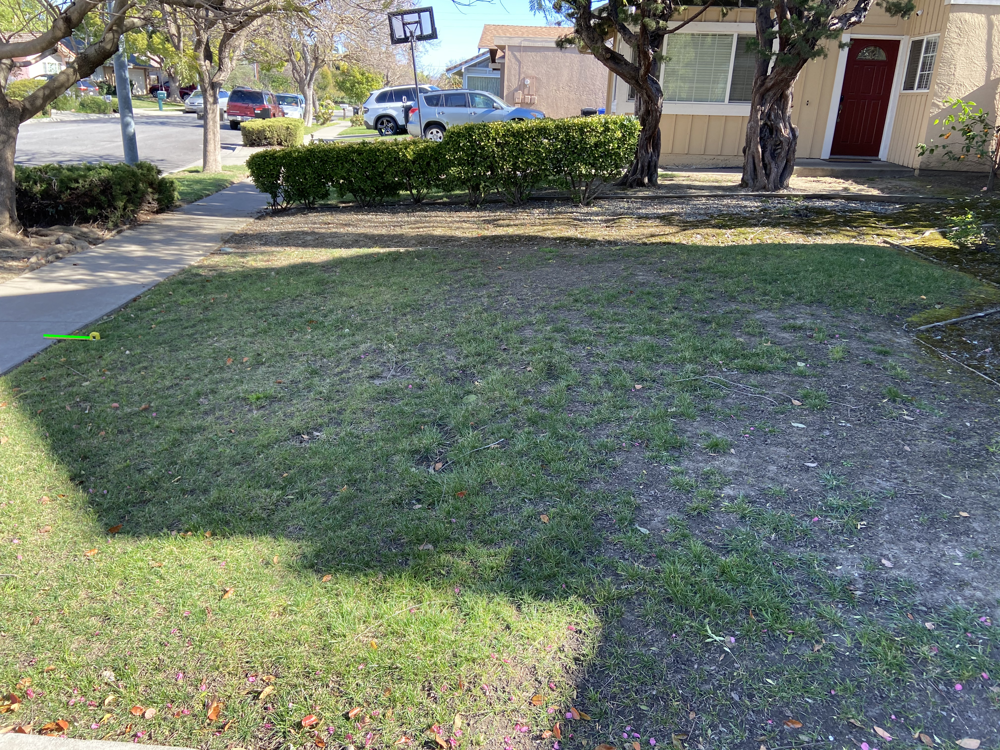

In [ ]:
img_ft = Image.open("FeetToPixel.JPG")

ft_line = ImageDraw.Draw(img_ft)
ft_line.line([(175, 1351), (362, 1360)], fill=(0, 255, 0), width=10)

ft_distance = np.sqrt(9*9 + 187*187)
print(ft_distance)

img_ft

1255.5 893.5
Distance =  12.7618753960143 ft
42.251911819946244


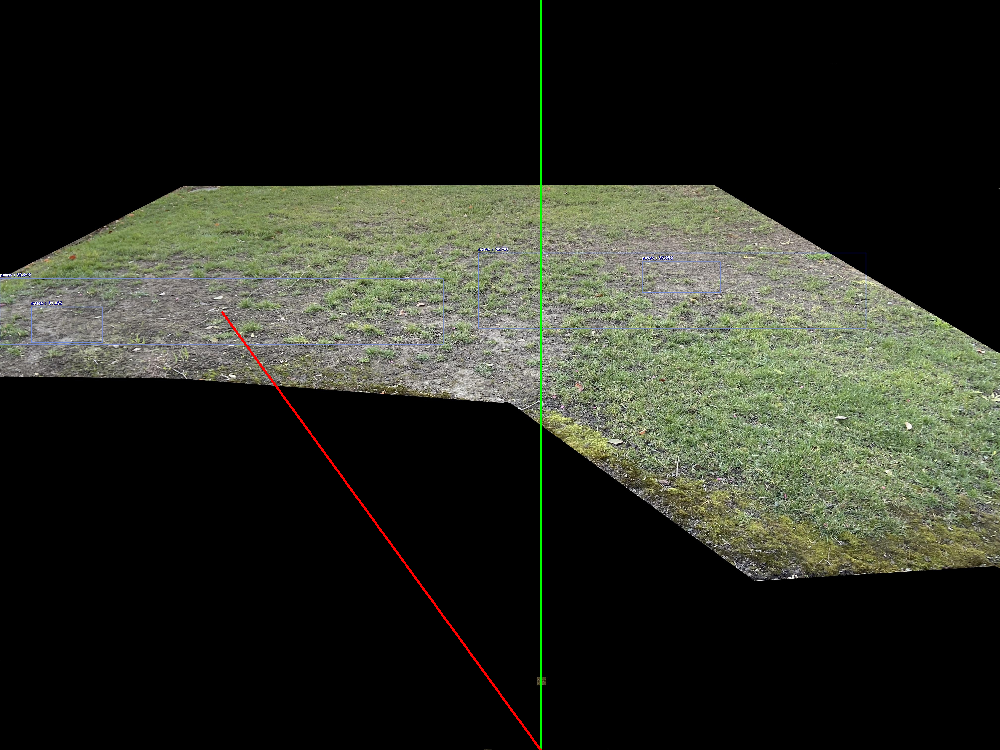

In [ ]:
from PIL import Image, ImageDraw

#TOP LEFT = [0, 1]
#BOTTOM LEFT = [0, 3]
#TOP RIGHT = [2, 1]
#BOTTOM RIGHT = [2, 3]

img = Image.open("SprinklerPOV_Detected.jpg")
middle_line = ImageDraw.Draw(img)
avg_1Line = ImageDraw.Draw(img)
avg_2Line = ImageDraw.Draw(img)

avg_1 = (coord_array[1][1] + coord_array[1][3])/2
avg_2 = (coord_array[1][0] + coord_array[1][2])/2

middle_line.line([(2180, 0), (2180, 3024)], fill=(0, 255, 0), width=10)
# avg_1Line.line([(coord_array[1][0], coord_array[1][1]), (coord_array[1][0], coord_array[1][3])], fill=(255, 0, 0), width=10)
# avg_2Line.line([(coord_array[1][0], coord_array[1][3]), (coord_array[1][2], coord_array[1][3])], fill=(255, 0, 0), width=10)

def find_angle():
  line_to_patch = ImageDraw.Draw(img)
  line_to_patch.line([(avg_2, avg_1), (2180, 3024)], fill=(255, 0, 0), width=10)
  length_1_vertical = 3024 - avg_1
  length_2_horizontal = 2500 - avg_2
  print("Distance = ", np.sqrt(length_1_vertical*length_1_vertical + length_2_horizontal*length_2_horizontal)/ft_distance, "ft")
  angle_radians = np.arctan(length_2_horizontal/length_1_vertical)
  angle = (180/(np.pi/angle_radians)) #Convert radians to degrees
  return angle

print(avg_1, avg_2)
print(find_angle())

img
